In [30]:
import IPython.display as display
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.optim import lr_scheduler
from torchvision import transforms

SyntaxError: leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (<ipython-input-30-fd7ce7ed14dd>, line 15)

## Import data

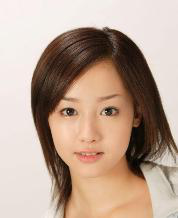

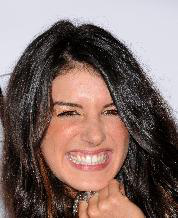

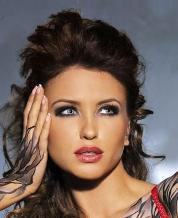

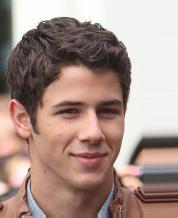

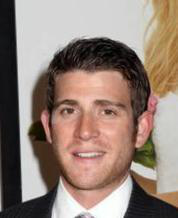

...

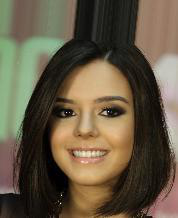

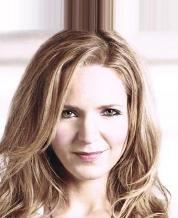

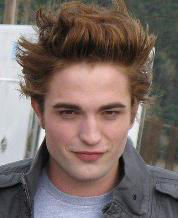

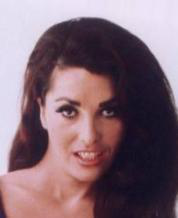

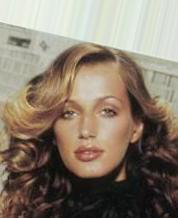

In [2]:
image_directory = r'/Users/xiaoyuxu/Desktop/Face_Imgs'
image_files = [f for f in os.listdir(image_directory) if f.endswith(".jpg")]

# Load and display each image
for image_file in image_files:
    full_path = os.path.join(image_directory, image_file)
    image = Image.open(full_path) #each image has size: 178*218
    display.display(image)

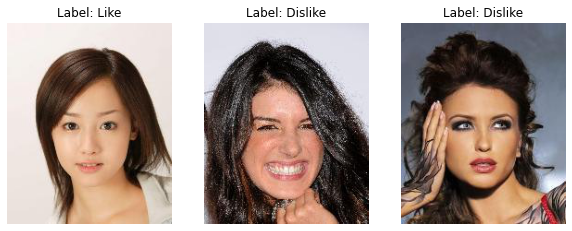

In [37]:
def show_images(image_paths, labels):
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))

    for i in range(3):
        img_path = os.path.join(image_directory, image_paths[i])
        img = Image.open(img_path).convert('RGB')
        label = "Dislike" if labels[i] == 0 else "Like"

        axs[i].imshow(img)
        axs[i].set_title(f"Label: {label}")
        axs[i].axis('off')

    plt.show()

# Display two images and their labels
show_images(image_files[:3], labels[:3])

## Sort data

In [32]:
target_size = (64, 64)

# Labels extraction
labels = [int(file.split('_')[1].split('.')[0]) for file in image_files]
thres_hold = labels.count(1)/len(labels)
labels = torch.tensor(labels, dtype=torch.float32).view(-1, 1)

# Split Dataset
X_train, X_temp, y_train, y_temp = train_test_split(image_files, labels, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Define a custom dataset
class CustomDataset(Dataset):
    def __init__(self, file_paths, labels, transform=None):
        self.file_paths = file_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.file_paths)

    def __getitem__(self, idx):
        img = Image.open(os.path.join(image_directory, self.file_paths[idx])).convert('RGB')

        if self.transform:
            img = self.transform(img)

        label = self.labels[idx]
        label = label.view(-1, 1).squeeze(1)  # Ensure label has the same size as model output
        return img, label


# Define transformations
transform = transforms.Compose([
    transforms.RandomResizedCrop(target_size),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor()
])

# Helper function to create DataLoader
def create_dataloader(dataset, batch_size, shuffle):
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)

# Create datasets and data loaders
train_dataset = CustomDataset(X_train, y_train, transform=transform)
val_dataset = CustomDataset(X_val, y_val, transform=transform)
test_dataset = CustomDataset(X_test, y_test, transform=transform)

# Create data loaders
batch_size = 16
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

## CNN model using PyTorch

In [4]:
def init_weights(m):
    if type(m) == nn.Conv2d or type(m) == nn.Linear:
        nn.init.xavier_uniform_(m.weight)
        
class ComplexCNNModel(nn.Module):
    def __init__(self):
        super(ComplexCNNModel, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(64 * 16 * 16, 128)
        self.fc2 = nn.Linear(128, 64)
        self.fc3 = nn.Linear(64, 100)
        self.fc4 = nn.Linear(100, 50)
        self.dropout = nn.Dropout(0.2)
        self.fc5 = nn.Linear(50, 1)

        # Initialize weights using Xavier initialization
        self.apply(init_weights)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 64 * 16 * 16)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.sigmoid(self.fc3(x))
        x = F.sigmoid(self.fc4(x))
        x = self.dropout(x)
        x = self.fc5(x)
        return x

In [5]:
class SimpleCNNModel(nn.Module):
    def __init__(self):
        super(SimpleCNNModel, self).__init__()
        self.conv1 = nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
        self.fc1 = nn.Linear(16 * 32 * 32, 64)
        self.bn2 = nn.BatchNorm1d(64)
        self.fc2 = nn.Linear(64, 1)

        # Initialize weights using Xavier initialization
        self.apply(init_weights)
        self.dropout = nn.Dropout(0.2)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = x.view(-1, 16 * 32 * 32)
        x = F.relu(self.fc1(x))
        x = F.sigmoid(self.fc2(x))
        return x

## Train the model

In [22]:
model = SimpleCNNModel()

# Define the loss function and optimizer
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

# Training loop
num_epochs = 32
train_losses = []
val_losses = []
val_accuracies = []

for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0

    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        outputs = outputs.view(-1, 1)
        loss = criterion(outputs, labels)
        loss = loss.mean()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1)
        optimizer.step()

        train_loss += loss.item()

    average_train_loss = train_loss / len(train_loader)
    train_losses.append(average_train_loss)

    print(f"Epoch {epoch + 1}/{num_epochs}, Training Loss: {average_train_loss}")

    # Validation loop
    model.eval()
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for val_inputs, val_labels in val_loader:
            val_outputs = model(val_inputs)
            val_outputs = val_outputs.view(-1, 1)
            val_loss += criterion(val_outputs, val_labels).item()

            # Calculate accuracy
            predicted = (val_outputs > 0.35).float()
            correct += (predicted == val_labels).sum().item()
            total += val_labels.size(0)

    average_val_loss = val_loss / len(val_loader)
    val_losses.append(average_val_loss)

    val_accuracy = correct / total
    val_accuracies.append(val_accuracy)

    print(f"Validation Loss: {average_val_loss}, Validation Accuracy: {val_accuracy}")

# Test loop
model.eval()
test_loss = 0.0
correct = 0
total = 0

with torch.no_grad():
    for test_inputs, test_labels in test_loader:
        test_outputs = model(test_inputs)
        test_outputs = test_outputs.view(-1, 1)
        test_loss += criterion(test_outputs, test_labels).item()

        # Calculate accuracy
        predicted = (test_outputs > 0.35).float()
        correct += (predicted == test_labels).sum().item()
        total += test_labels.size(0)

average_test_loss = test_loss / len(test_loader)
test_accuracy = correct / total

print(f"Test Loss: {average_test_loss}, Test Accuracy: {test_accuracy}")

Epoch 1/32, Training Loss: 0.6211767998234979
Validation Loss: 0.5230653307267598, Validation Accuracy: 0.7525773195876289
Epoch 2/32, Training Loss: 0.6024210956589929
Validation Loss: 0.5292373299598694, Validation Accuracy: 0.711340206185567
Epoch 3/32, Training Loss: 0.5969622577058857
Validation Loss: 0.7780247500964573, Validation Accuracy: 0.29896907216494845
Epoch 4/32, Training Loss: 0.6188208409424486
Validation Loss: 0.5068945288658142, Validation Accuracy: 0.7216494845360825
Epoch 5/32, Training Loss: 0.5912989228963852
Validation Loss: 0.4978125052792685, Validation Accuracy: 0.7216494845360825
Epoch 6/32, Training Loss: 0.6122061343028627
Validation Loss: 0.5309034585952759, Validation Accuracy: 0.7422680412371134
Epoch 7/32, Training Loss: 0.591620293156854
Validation Loss: 0.5459659610475812, Validation Accuracy: 0.5773195876288659
Epoch 8/32, Training Loss: 0.6109729522261126
Validation Loss: 0.5044774583407811, Validation Accuracy: 0.7422680412371134
Epoch 9/32, Train

## Visualization of model performance

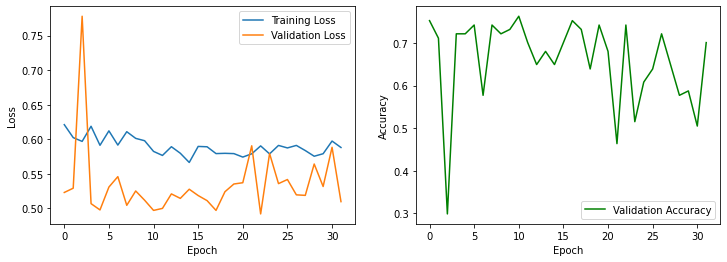

In [23]:
# Plotting
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(val_accuracies, label='Validation Accuracy', color='green')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

## Model prediction

Test Loss: 0.1355654171534947, Test Accuracy: 0.75


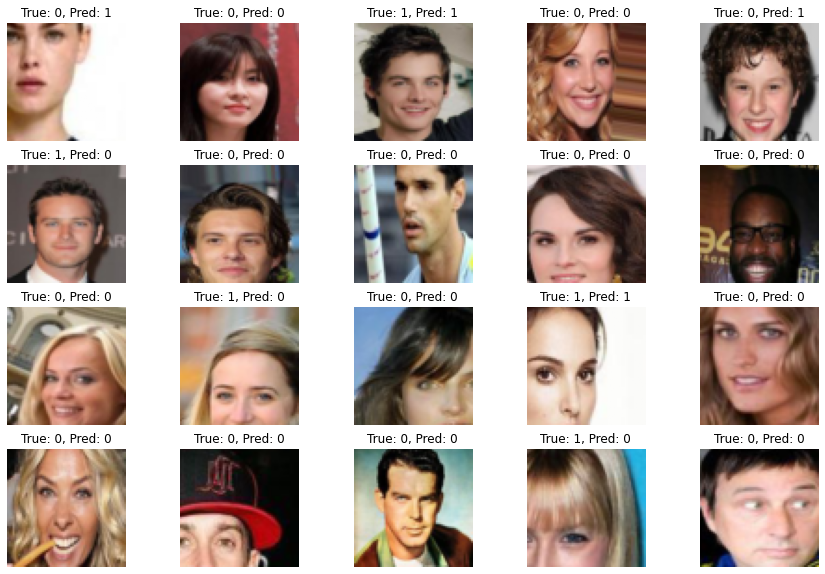

In [28]:
# Test loop
model.eval()
test_loss = 0.0
correct = 0
total = 0

# Number of images to visualize
num_images_to_visualize = 20

# Lists to store images, true labels, and predicted labels
visualize_images = []
visualize_true_labels = []
visualize_pred_labels = []

with torch.no_grad():
    for i, (test_inputs, test_labels) in enumerate(test_loader):
        test_outputs = model(test_inputs)
        test_outputs = test_outputs.view(-1, 1)
        test_loss += criterion(test_outputs, test_labels).item()

        # Calculate accuracy
        predicted = (test_outputs > 0.35).float()
        correct += (predicted == test_labels).sum().item()
        total += test_labels.size(0)

        # Store information for visualization
        for j in range(min(test_labels.size(0), num_images_to_visualize)):
            visualize_images.append(test_inputs[j].numpy())
            visualize_true_labels.append(test_labels[j].item())
            visualize_pred_labels.append(predicted[j].item())

        if total >= num_images_to_visualize:
            break

# Average test loss and accuracy
average_test_loss = test_loss / len(test_loader)
test_accuracy = correct / total

print(f"Test Loss: {average_test_loss}, Test Accuracy: {test_accuracy}")

# Visualize the images
plt.figure(figsize=(15, 10))
for i in range(num_images_to_visualize):
    plt.subplot(4, 5, i + 1)
    plt.imshow(np.transpose(visualize_images[i], (1, 2, 0)))
    plt.title(f"True: {int(visualize_true_labels[i])}, Pred: {int(visualize_pred_labels[i])}")
    plt.axis('off')

plt.show()
